In [5]:
import pandas as pd
import folium
import pandas as pd
import json
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
df_alimentacao = pd.read_csv('dados/alimentacao.csv')

In [7]:
df_alimentacao.head()

,id,UF,Esperança de vida ao nascer (Anos),Situação Censitária,Área,Peso Final,Altura Final,Está grávida?,Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?,"Considerando a comida preparada na hora e os alimentos industrializados,acha que o seu consumo de sal é:",dias_semana_leguminosas e verduras,dias_semana_carnes,dias_semana_bebida artificial,dias_semana_bebida natural,dias_semana_frutas,dias_semana_leite,dias_semana_doces industrializados
0,0,RO,71.91,1,1,60.0,145.0,2.0,0.0,3.0,4.0,4.000000,4.0,0.0,3.0,7.0,0.0
1,9,RO,71.91,1,1,65.0,152.0,2.0,0.0,3.0,5.5,2.000000,1.0,0.0,0.0,0.0,0.0
2,10,RO,71.91,1,1,77.0,155.0,2.0,0.0,4.0,7.0,3.333333,0.0,7.0,7.0,0.0,0.0
3,18,RO,71.91,1,1,56.0,159.0,2.0,0.0,3.0,5.0,4.333333,1.5,3.0,3.0,0.0,0.0
4,19,RO,71.91,1,1,55.0,176.0,2.0,0.0,3.0,3.0,2.000000,1.5,4.0,3.0,7.0,2.0


In [8]:
df_alimentacao.shape

(90846, 17)

In [9]:
df_corr = df_alimentacao.drop(columns = ['Está grávida?'])

C:\Users\ferrem48\AppData\Local\Temp\ipykernel_3436\1371259242.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlacao = df_corr.corr()


Text(0.5, 1.0, 'Matriz de Correlação')

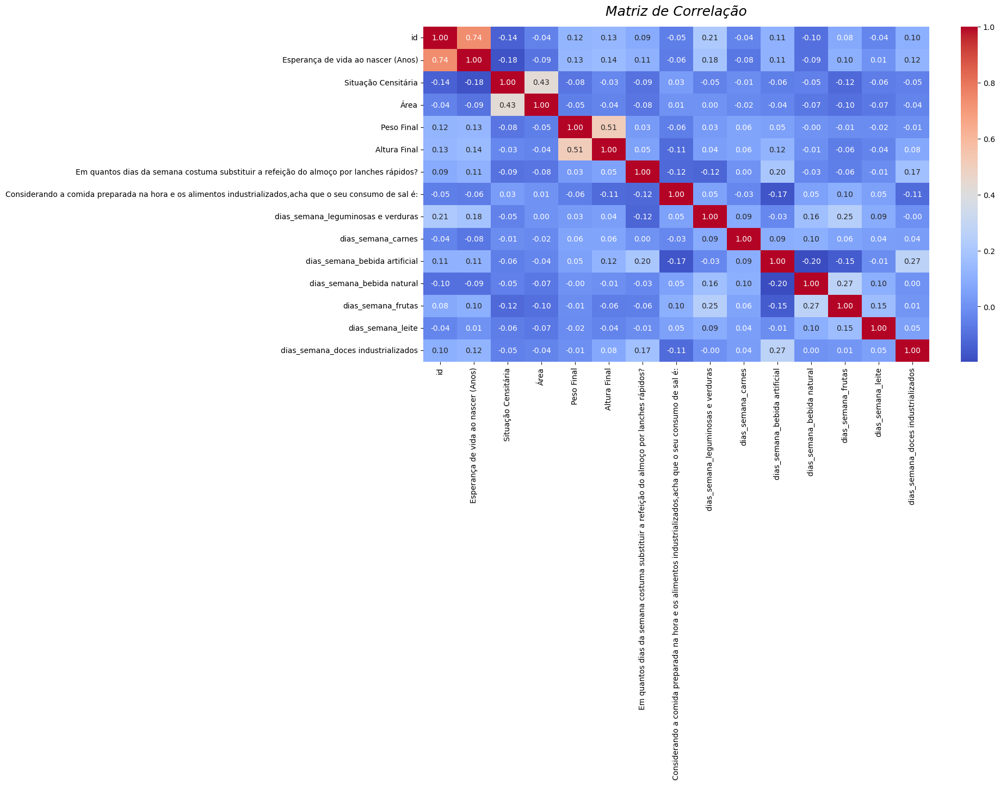

In [10]:
correlacao = df_corr.corr()
plt.figure(figsize=(15, 8))
sns.heatmap(correlacao, annot=True, cmap="coolwarm", fmt=".2f")
plt.title('Matriz de Correlação', fontsize = 18, style = "italic", loc = "center", pad = 15)

In [6]:
situacao_uf = df_alimentacao.groupby(['UF', 'Situação Censitária']).size().unstack(fill_value=0)
situacao_uf

Situação Censitária,1,2
UF,,
AC,1660,720
AL,2218,769
AM,2480,999
AP,1349,205
BA,2573,1086
CE,2929,1336
DF,2194,171
ES,3096,445
GO,2267,435


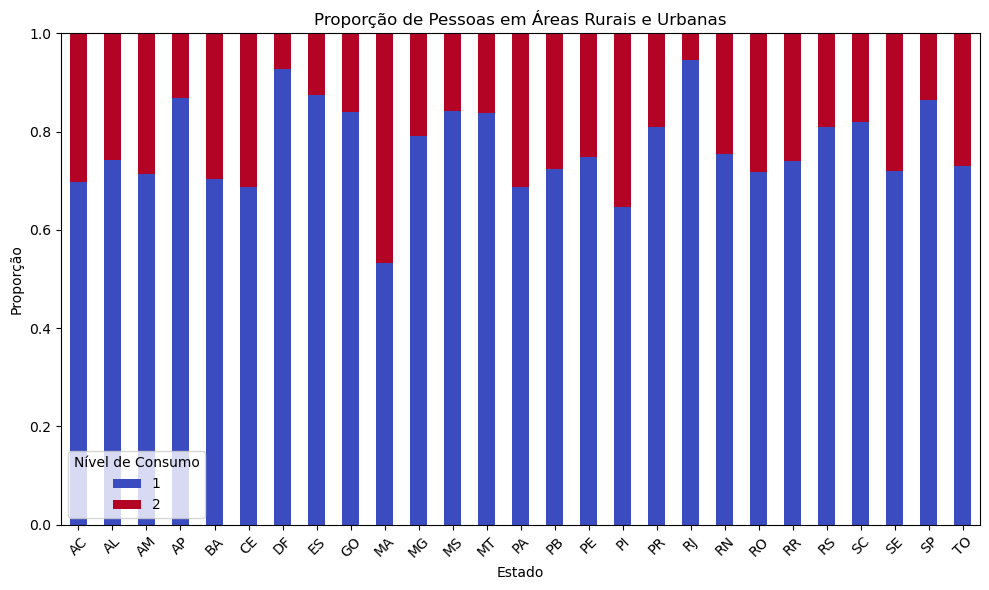

In [7]:
# Calculando proporções
proporcoes = situacao_uf.div(situacao_uf.sum(axis=1), axis=0)

# Configuração do gráfico
fig, ax = plt.subplots(figsize=(10, 6))

# Gráfico de barras empilhadas com proporções
proporcoes.plot(kind='bar', stacked=True, ax=ax, colormap='coolwarm')

# Configurações adicionais
plt.title('Proporção de Pessoas em Áreas Rurais e Urbanas')
plt.xlabel('Estado')
plt.ylabel('Proporção')
plt.legend(title='Nível de Consumo')
plt.xticks(rotation=45)
plt.ylim(0, 1)  # Definindo o limite do eixo Y para 0 a 1
plt.tight_layout()

# Exibição do gráfico
plt.show()

In [8]:
pessoas_uf = df_alimentacao.groupby('UF').size().reset_index(name='count').sort_values(by='count', ascending=False)
pessoas_uf

,UF,count
25,SP,6114
10,MG,5209
9,MA,5080
18,RJ,4966
5,CE,4265
15,PE,4083
17,PR,3967
13,PA,3853
22,RS,3767
23,SC,3738


In [10]:
# Carregando o geojson das UFs (você pode precisar ajustar o caminho do arquivo)
with open(r'dados\uf.json', encoding='ISO-8859-1') as f:
    geojson_data = json.load(f)

In [11]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=pessoas_uf,
    columns=['UF', 'count'],
    key_on='feature.properties.UF_05',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Quantidade de Pessoas por UF',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [12]:
almoco_lanche_uf = df_alimentacao.groupby('UF')['Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?'].mean().reset_index()
almoco_lanche_uf

,UF,Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?
0,AC,0.275210
1,AL,0.401071
2,AM,0.382006
3,AP,0.315959
4,BA,0.327685
5,CE,0.359203
6,DF,0.517548
7,ES,0.397063
8,GO,0.456329
9,MA,0.262402


In [13]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=almoco_lanche_uf,
    columns=['UF', 'Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?'],
    key_on='feature.properties.UF_05',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Substituição do Almoço por Lanches Rápidos',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [14]:
sal_uf = df_alimentacao.groupby(['UF', 'Considerando a comida preparada na hora e os alimentos industrializados,acha que o seu consumo de sal é:']).size().unstack(fill_value=0)
sal_uf

"Considerando a comida preparada na hora e os alimentos industrializados,acha que o seu consumo de sal é:",1.0,2.0,3.0,4.0,5.0
UF,,,,,
AC,21,216,1421,643,79
AL,39,302,1652,845,149
AM,105,284,2022,957,111
AP,28,152,876,432,66
BA,39,304,2018,1075,223
CE,31,327,2623,1189,95
DF,22,230,1501,537,75
ES,55,321,2143,856,166
GO,22,227,1691,689,73


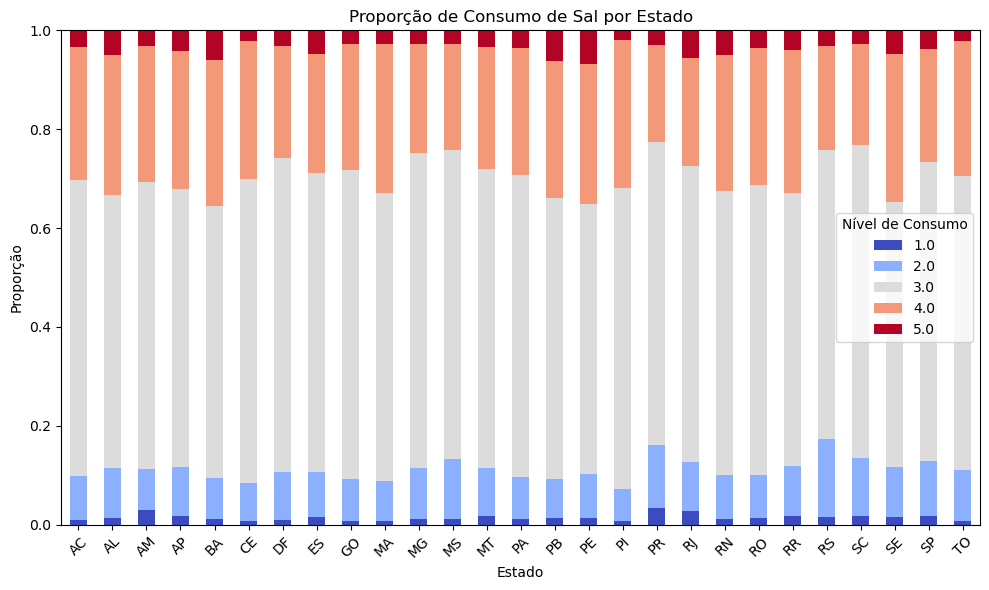

In [15]:
# Calculando proporções
proporcoes = sal_uf.div(sal_uf.sum(axis=1), axis=0)

# Configuração do gráfico
fig, ax = plt.subplots(figsize=(10, 6))

# Gráfico de barras empilhadas com proporções
proporcoes.plot(kind='bar', stacked=True, ax=ax, colormap='coolwarm')

# Configurações adicionais
plt.title('Proporção de Consumo de Sal por Estado')
plt.xlabel('Estado')
plt.ylabel('Proporção')
plt.legend(title='Nível de Consumo')
plt.xticks(rotation=45)
plt.ylim(0, 1)  # Definindo o limite do eixo Y para 0 a 1
plt.tight_layout()

# Exibição do gráfico
plt.show()

In [16]:
leguminosas_verdura_uf = df_alimentacao.groupby('UF')['dias_semana_leguminosas e verduras'].mean().reset_index()
leguminosas_verdura_uf

,UF,dias_semana_leguminosas e verduras
0,AC,4.144748
1,AL,4.840978
2,AM,3.411469
3,AP,3.749678
4,BA,4.742006
5,CE,4.463189
6,DF,5.190698
7,ES,5.394521
8,GO,5.423760
9,MA,3.714370


In [17]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=leguminosas_verdura_uf,
    columns=['UF', 'dias_semana_leguminosas e verduras'],
    key_on='feature.properties.UF_05',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Leguminosas e Verduras',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [18]:
carne_uf = df_alimentacao.groupby('UF')['dias_semana_carnes'].mean().reset_index()
carne_uf

,UF,dias_semana_carnes
0,AC,2.634034
1,AL,2.533199
2,AM,2.732490
3,AP,2.646718
4,BA,2.400747
5,CE,2.201329
6,DF,2.524736
7,ES,2.326179
8,GO,2.654083
9,MA,2.435827


In [19]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=carne_uf,
    columns=['UF', 'dias_semana_carnes'],
    key_on='feature.properties.UF_05',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Carnes',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [20]:
bebidas_artificiais_uf = df_alimentacao.groupby('UF')['dias_semana_bebida artificial'].mean().reset_index()
bebidas_artificiais_uf

,UF,dias_semana_bebida artificial
0,AC,1.338025
1,AL,1.028457
2,AM,1.238574
3,AP,1.443372
4,BA,0.704017
5,CE,1.007503
6,DF,1.181818
7,ES,0.961734
8,GO,1.561991
9,MA,0.765453


In [21]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=bebidas_artificiais_uf,
    columns=['UF', 'dias_semana_bebida artificial'],
    key_on='feature.properties.UF_05',
    fill_color='Purples',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Bebidas Artificiais',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [22]:
bebidas_naturais_uf = df_alimentacao.groupby('UF')['dias_semana_bebida natural'].mean().reset_index()
bebidas_naturais_uf

,UF,dias_semana_bebida natural
0,AC,2.615546
1,AL,3.265484
2,AM,2.640701
3,AP,2.662162
4,BA,3.401476
5,CE,3.015006
6,DF,2.880761
7,ES,2.592206
8,GO,2.217246
9,MA,2.201772


In [23]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=bebidas_naturais_uf,
    columns=['UF', 'dias_semana_bebida natural'],
    key_on='feature.properties.UF_05',
    fill_color='YlOrBr',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Bebidas Naturais',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [24]:
frutas_uf = df_alimentacao.groupby('UF')['dias_semana_frutas'].mean().reset_index()
frutas_uf

,UF,dias_semana_frutas
0,AC,3.366387
1,AL,3.958152
2,AM,3.645300
3,AP,3.687902
4,BA,3.960918
5,CE,3.971864
6,DF,4.595349
7,ES,4.020898
8,GO,3.905255
9,MA,3.636024


In [25]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=frutas_uf,
    columns=['UF', 'dias_semana_frutas'],
    key_on='feature.properties.UF_05',
    fill_color='GnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Frutas',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [26]:
leite_uf = df_alimentacao.groupby('UF')['dias_semana_leite'].mean().reset_index()
leite_uf

,UF,dias_semana_leite
0,AC,4.080252
1,AL,2.843321
2,AM,3.685829
3,AP,4.254826
4,BA,4.000000
5,CE,3.421102
6,DF,3.271036
7,ES,3.384355
8,GO,3.343079
9,MA,3.639370


In [27]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=leite_uf,
    columns=['UF', 'dias_semana_leite'],
    key_on='feature.properties.UF_05',
    fill_color='YlOrBr',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Leite',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [28]:
doces_uf = df_alimentacao.groupby('UF')['dias_semana_doces industrializados'].mean().reset_index()
doces_uf

,UF,dias_semana_doces industrializados
0,AC,1.414706
1,AL,1.502176
2,AM,1.292325
3,AP,1.561133
4,BA,1.501503
5,CE,1.769285
6,DF,1.734461
7,ES,1.799209
8,GO,1.725389
9,MA,1.070276


In [29]:
# Criando um mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4)

# Adicionando o mapa coroplético
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=doces_uf,
    columns=['UF', 'dias_semana_doces industrializados'],
    key_on='feature.properties.UF_05',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Doces',
)

# Adicionar o coroplético ao mapa
choropleth.add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_coropletico.html')

# Exibir o mapa
m

In [38]:
# Carregar o geojson das UFs
with open(r'dados\uf.json', encoding='ISO-8859-1') as f:
    geojson_data = json.load(f)

# Criar o mapa base
m = folium.Map(location=(-14.2350, -51.9253), zoom_start=4, tiles='Cartodb Positron')

# Adicionar o primeiro Choropleth (doses de bebida alcoólica), mas sem exibi-lo inicialmente
choropleth1 = folium.Choropleth(
    geo_data=geojson_data,
    data=pessoas_uf,
    columns=['UF', 'count'],
    key_on='feature.properties.UF_05',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Quantidade de Pessoas por UF',
    name='Quantidade de Pessoas por UF',
    show=False
).add_to(m)

# Adicionar o segundo Choropleth (frequência semanal de consumo de álcool), mas sem exibi-lo inicialmente
choropleth2 = folium.Choropleth(
    geo_data=geojson_data,
    data=almoco_lanche_uf,
    columns=['UF', 'Em quantos dias da semana costuma substituir a refeição do almoço por lanches rápidos?'],
    key_on='feature.properties.UF_05',
    fill_color='Oranges',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Substituição do Almoço por Lanches Rápidos',
    name='Média Substituição do Almoço por Lanches Rápidos',
    show=False
).add_to(m)

# Adicionar o terceiro Choropleth (consumo de leguminosas e verduras), mas sem exibi-lo inicialmente
choropleth3 = folium.Choropleth(
    geo_data=geojson_data,
    data=leguminosas_verdura_uf,
    columns=['UF', 'dias_semana_leguminosas e verduras'],
    key_on='feature.properties.UF_05',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Leguminosas e Verduras',
    name='Média Consumo de Leguminosas e Verduras',
    show=False
).add_to(m)

# Adicionar o quarto Choropleth (consumo de carnes), mas sem exibi-lo inicialmente
choropleth4 = folium.Choropleth(
    geo_data=geojson_data,
    data=carne_uf,
    columns=['UF', 'dias_semana_carnes'],
    key_on='feature.properties.UF_05',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Carnes',
    name='Média Consumo de Carnes',
    show=False
).add_to(m)

choropleth5 = folium.Choropleth(
    geo_data=geojson_data,
    data=bebidas_artificiais_uf,
    columns=['UF', 'dias_semana_bebida artificial'],
    key_on='feature.properties.UF_05',
    fill_color='Purples',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Bebidas Artificiais',
    name = 'Média Consumo de Bebidas Artificiais',
    show = False
).add_to(m)

choropleth6 = folium.Choropleth(
    geo_data=geojson_data,
    data=bebidas_naturais_uf,
    columns=['UF', 'dias_semana_bebida natural'],
    key_on='feature.properties.UF_05',
    fill_color='YlOrBr',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Bebidas Naturais',
    name = 'Média Consumo de Bebidas Naturais',
    show = False
).add_to(m)

choropleth7 = folium.Choropleth(
    geo_data=geojson_data,
    data=frutas_uf,
    columns=['UF', 'dias_semana_frutas'],
    key_on='feature.properties.UF_05',
    fill_color='GnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Frutas',
    name = 'Média Consumo de Frutas',
    show = False
).add_to(m)

choropleth8 = folium.Choropleth(
    geo_data=geojson_data,
    data=leite_uf,
    columns=['UF', 'dias_semana_leite'],
    key_on='feature.properties.UF_05',
    fill_color='YlOrBr',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Leite',
    name = 'Média Consumo de Leite',
    show = False
).add_to(m)

choropleth = folium.Choropleth(
    geo_data=geojson_data,
    data=doces_uf,
    columns=['UF', 'dias_semana_doces industrializados'],
    key_on='feature.properties.UF_05',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Média Consumo de Doces',
    name = 'Média Consumo de Doces',
    show = False
).add_to(m)

# Adicionar o controle de camadas para alternar entre as camadas
folium.LayerControl(collapsed=True).add_to(m)

# Salvar o mapa em um arquivo HTML
# m.save('mapa_com_camadas_coropletico.html')

# Exibir o mapa
m
